In [1]:
using Plots #Gráficos
using LinearAlgebra #Álgebra lineal
using Distributions #Distribuciones de probabilidad
using Statistics #Estadística

In [2]:
function MetEuler(f, p, y0, t0, tn, h)
    # Método de Euler. Implementación propia
    
    # f: función que define la EDO dy/dt = f(t, y; p)
    # y0: condición inicial
    # t0: tiempo inicial
    # tn: tiempo final
    # h: tamaño del paso
    # p: parámetros de la función f

    # Número de pasos
    n_steps = Int((tn - t0) / h)
    
    t_values = zeros(n_steps + 1)
    y_values = zeros(n_steps + 1)

    # Acondiciones iniciales
    t_values[1] = t0
    y_values[1] = y0

    # Método de Euler
    for i in 1:n_steps
        t_values[i + 1] = t_values[i] + h
        y_values[i + 1] = y_values[i] + h * f(t_values[i], y_values[i],p)
    end

    return t_values, y_values
end

MetEuler (generic function with 1 method)

# Metrópolis-Hastings Random Walk Precondicionado

## MHRW sin precondicionamiento

Como se realizó en otros cuadernos, a continuación se crean datos artificiales para evaluar el modelo de crecimiento logístico el cual depende de dos parámetros.

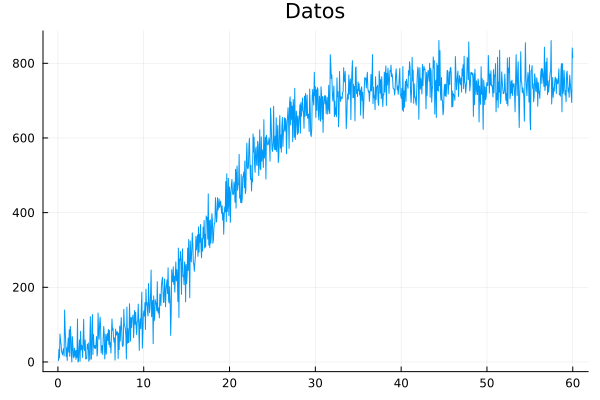

In [3]:
x0 = 20  # Población inicial
r0 = 0.2 # Tasa de crecimiento
K0 = 750 # Capacidad de carga
Tiempo = (1:1000)*(60/1000)

function sol_analitica(p)
    # solucion exacta de la ecuacion logistica 
    return x0 * p[2] ./ (x0 .+ (p[2] - x0) * exp.(-p[1] * Tiempo) )
end

function rhs(t,x,p)
    return p[1] * x * (1- x/p[2])
end
function sol_numerica(p)
    # solucion numérica de la ecuacion logistica 
    ti = 0
    tf = 60 
    d = 1000
    h = (tf-ti)/(d-1)
    return MetEuler(rhs,p,x0,ti,tf,h)[2]
end

#Construcción de los datos con el modelo analítico 
Crecimiento = sol_analitica((r0,K0)) + 40*randn(1000) #Adición de ruido
Crecimiento = Int.(floor.(abs.(Crecimiento)))

plot(Tiempo, Crecimiento,title="Datos", label=false)

Se define la función de log-energía que es proporcional a la probabilidad condicional que tienen los parámetros dados los datos obtenidos. También se usa una restricción de los parámetros a cierta región para que la búsqueda del algoritmo MH se más eficiente. Los contornos de la función de log-energía son graficados.

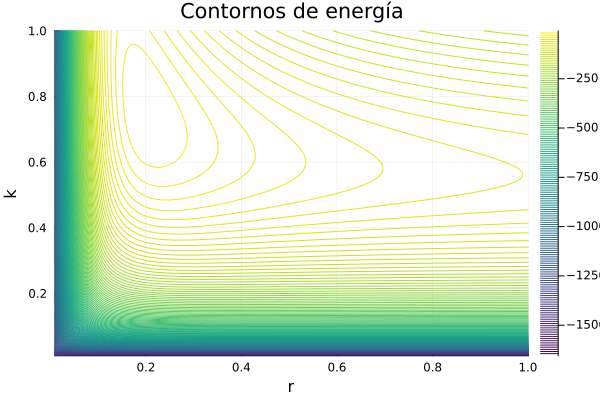

In [4]:
function energy(p) # log of the posterior
    r = 1*p[1]
    k = 1000*p[2]
    noisy_data = Crecimiento
    mu = sol_numerica((r,k))

    # poisson
    log_likelihood = sum(logpdf.(Poisson.(mu), noisy_data))
    
    # gaussian
    #log_likelihood = sum(logpdf.(Normal.(mu, 100.0), noisy_data))
    
    log_prior = logpdf(Gamma(1,1), r) + logpdf(Gamma(1000,1), k)
    
    return (log_likelihood + log_prior)*(10^(-3))
end


function support(pa)
    # soporte de los parametros ""
    rt = true
    rt &= (0.0 < pa[1] < 1.0)
    rt &= (0.0 < pa[2] < 1.0)
    return rt
end



f(x, y) = energy((x,y))

x_range = 0.01:0.01:1
y_range = 0.01:0.01:1

# Inicializar matrices para la malla
mesh_x = zeros(length(x_range), length(y_range))
mesh_y = zeros(length(x_range), length(y_range))
# Llenar las matrices de la malla con valores de x e y
for i in 1:length(x_range)
    for j in 1:length(y_range)
        mesh_x[i, j] = x_range[i]
        mesh_y[i, j] = y_range[j]
    end
end
# Evaluar la función en cada punto de la malla
z_values = f.(mesh_y, mesh_x)

# Crear el gráfico de contornos
contour(x_range, y_range, z_values, levels=150, color=:viridis, xlabel="r", ylabel="k", title="Contornos de energía")

Los anteriores contornos de energía muestran una evidente concentración de energía en cierto punto del soporte de los parámetros; se espera que el algoritmo MHRW tenga la capacidad de hallar la distribución a posteriori de los parámetros indicando la concentración de energía. El siguiente código ejecuta el algoritmo para el problema en cuestión.

In [5]:
# Número de iteraciones
iterations = 10000
# Punto inicial donde r y K seleccionados de manera aleatoria en (0,1)
samplesED = rand(2) 

probabilitiesED = [exp(energy(samplesED[:,end]))] # energía

Alpha = [0] # tasa de aceptación
sd = 0.1 # desviación estándar del camino aleatorio

# MHRW
for i in 1:iterations
    # Construcción de nuevas muestras con un camino aleatorio normal
    theta = samplesED[:,end]+ sd*randn(2)

    # Condición del soporte
    if support(theta) == false
        alpha = 0
        p2 = exp(energy(samplesED[:,end]))
    else
        p1 = exp(energy(theta))
        p2 = exp(energy(samplesED[:,end]))
        alpha = min(1, p1/p2)
    end 
    
    Alpha = hcat(Alpha,alpha)
    u = rand()

    #Selección de muestras
    if u < alpha
        samplesED = hcat(samplesED, theta)
        probabilitiesED = hcat(probabilitiesED,p1)
    else
        samplesED = hcat(samplesED, samplesED[:,end])
        probabilitiesED = hcat(probabilitiesED,p2)
    end
end



initial_position = floor(100*rand())
leap = 20
samplesED_ss = samplesED[:, Int(initial_position):leap:end]
probabilitiesED_ss = probabilitiesED[Int(initial_position):leap:end];

max_probED, positionED_ss = findmax(probabilitiesED_ss)
Max_likelihoodED = samplesED_ss[:, positionED_ss]
MeanED = mean(samplesED_ss, dims=2)

@show (r0,K0)
@show Max_likelihoodED
@show MeanED;

(r0, K0) = (0.2, 750)
Max_likelihoodED = [0.19845883070310527, 0.750095649984586]
MeanED = [0.20180930577470615; 0.7504316833865629;;]


De acorde a lo anterior y a los parámetros con los que se construyeron los datos, el algoritmo MHRW muestra resultados certeros en ambas estadísticas que se esperan obtener que corresponde al punto de máxima energía y a la media condicional de la distribución a posteriori.

La información de este algoritmo se muestra gráficamente.

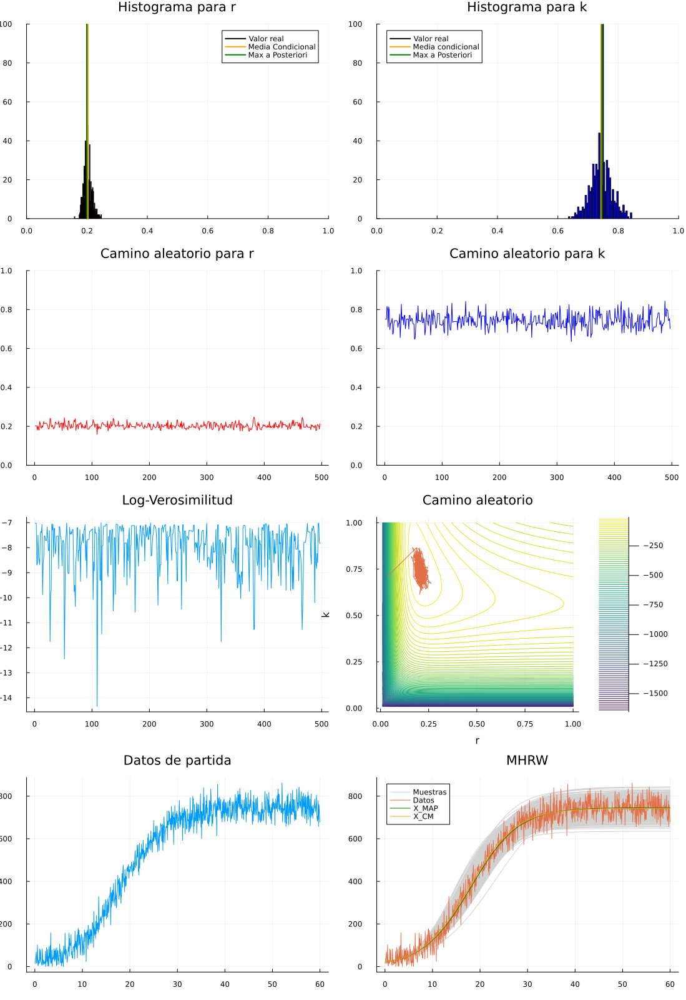

In [10]:
p1 = histogram(samplesED_ss[1,:],bins=50,label=false,color="red",xlim=(0,1),title="Histograma para r")
p1 = plot!([r0, r0], [0,100],linewidth=2,color="black", label="Valor real")
p1 = plot!([MeanED[1], MeanED[1]], [0,100],linewidth=2,color="orange", label="Media Condicional")
p1 = plot!([Max_likelihoodED[1], Max_likelihoodED[1]], [0,100],linewidth=2,color="green", label="Max a Posteriori")

p2 = histogram(samplesED_ss[2,:],bins=50,label=false,color="blue",xlim=(0,1),title="Histograma para k")
p2 = plot!([K0/10^3, K0/10^3],[0,100],linewidth=2, lcolor="black", label="Valor real")
p2 = plot!([MeanED[2], MeanED[2]], [0,100],linewidth=2,color="orange", label="Media condicional")
p2 = plot!([Max_likelihoodED[2], Max_likelihoodED[2]], [0,100],linewidth=2,color="green", label="Max a Posteriori")

p3 = plot(samplesED_ss[1,:],color="red",label = false,title="Camino aleatorio para r",ylim=(0,1))

p4 = plot(samplesED_ss[2,:],color="blue",label = false,title="Camino aleatorio para k",ylim=(0,1))

p5 = plot(log.(probabilitiesED_ss), label=false , title="Log-Verosimilitud")

p6 = contour(x_range, y_range, z_values, levels=100, color=:viridis, xlabel="r", ylabel="k",title="Camino aleatorio")
p6 = plot!(samplesED[1,:],samplesED[2,:],label=false)

p7 = plot(Tiempo, Crecimiento,label=false, title = "Datos de partida")

p8 = plot(Tiempo,sol_numerica((samplesED_ss[:,size(samplesED_ss)[2]][1],1000*samplesED_ss[:,size(samplesED_ss)[2]][2])),
    color="gray82",title="MHRW",label="Muestras",z=1,size=(1000, 600))
for j=1:(size(samplesED_ss)[2]-1)
   p8 = plot!(Tiempo,sol_numerica((1*samplesED_ss[:,j][1],1000*samplesED_ss[:,j][2])),color="gray82",label=false,z=1)
end
p8 = plot!(Tiempo, Crecimiento,label="Datos")
p8 = plot!(Tiempo, sol_numerica((Max_likelihoodED[1],1000*Max_likelihoodED[2])),color="green",label="X_MAP")
p8 = plot!(Tiempo, sol_numerica((MeanED[1],1000*MeanED[2])),color="orange",label="X_CM")


plot(p1,p2,p3,p4,p5,p6,p7,p8, layout=(4,2),size=(1100,1600))

Algo que no se mostró en los anteriores gráficos fue la tasa de aceptación del algoritmo almacenado en el objeto `Alpha`. Como se debe esperar, la gráfica de la tasa de aceptación varía aleatoriamente indicando que el algoritmo se ejecuta correctamente puesto que se espera que el rechazo o aceptación de una muestra se comporte como una variable aleatoria con distribución uniforme estándar. 

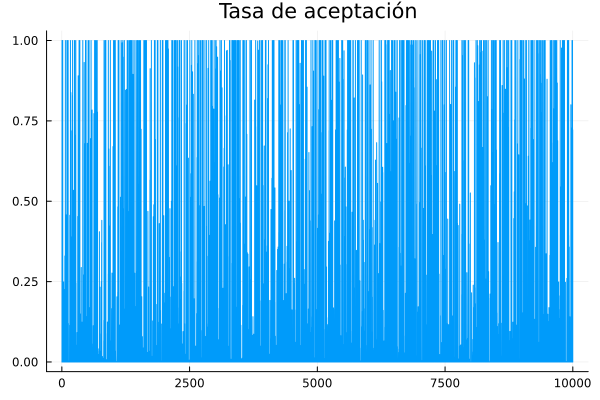

In [7]:
plot(Alpha[1,:],label="",title ="Tasa de aceptación")

## MHRW Precondicionado

En esta sección se plantea el problema de implementar el algoritmo MHRW precondicionado. El precondicionamiento hace referencia, en este caso, a evaluar las muestras con una función de energía "sencilla" y luego si estas muestras son aceptadas se evalúan en la energía que corresponde al modelo de interés para finalmente ser aceptadas o rechazadas. El objetivo de primero testear cada muestra en una función de energía "sencilla" es disminuir el costo computacional y a su vez incrementar la tasa de aceptación cuando se evalúe en la energía de interés.

Para este ejemplo podría modificarse la energía para que solo se tome tres puntos del vector de datos, como se muestra a continuación. 

In [8]:
Crecimiento[1:400:end]

3-element Vector{Int64}:
   4
 546
 742

Se crea la función soporte.

In [18]:
function support(pa)
    # soporte de los parametros ""
    rt = true
    rt &= (0.0 < pa[1] < 1.5)
    rt &= (0.0 < pa[2] < 1.5)
    return rt
end

support (generic function with 1 method)

Se crean ambas funciones de energía.

In [20]:
function energypre(p) # log of the posterior
    r = 1*p[1]
    k = 1000*p[2]
    noisy_data = Crecimiento[1:400:end]
    mu = sol_numerica((r,k))[1:400:end] #Aquí se usa el modelo numérico

    # poisson
    #log_likelihood = sum(logpdf.(Poisson.(mu), noisy_data))
    
    # gaussian
    log_likelihood = mean(logpdf.(Normal.(mu, 100.0), noisy_data))
    
    log_prior = logpdf(Gamma(1,1), r) + logpdf(Gamma(1000,1), k)
    
    return log_likelihood*0.1 + log_prior*0.01 
end

function energycomplete(p) # log of the posterior
    r = 1*p[1]
    k = 1000*p[2]
    noisy_data = Crecimiento
    mu = sol_numerica((r,k))  

    # poisson
    #log_likelihood = sum(logpdf.(Poisson.(mu), noisy_data))
    
    # gaussian
    log_likelihood = mean(logpdf.(Normal.(mu, 100.0), noisy_data))
    
    log_prior = logpdf(Gamma(1,1), r) + logpdf(Gamma(1000,1), k)
    
    return log_likelihood*0.1 + log_prior*0.01
end

# Nótese que en ambas funciones de energía se toma el promedio al hallar la 'log-likelihood',
# esto se hace con el fin de que cada una de las funciones tenga rangos similares y sean comparables de algún modo

energycomplete (generic function with 1 method)

A continuación se muestran los conjuntos de nivel para cada función de energía creada. Se evidencia graficamente la pérdida de información que se sufre al solo considerar unos pocos elementos del conjunto de datos.

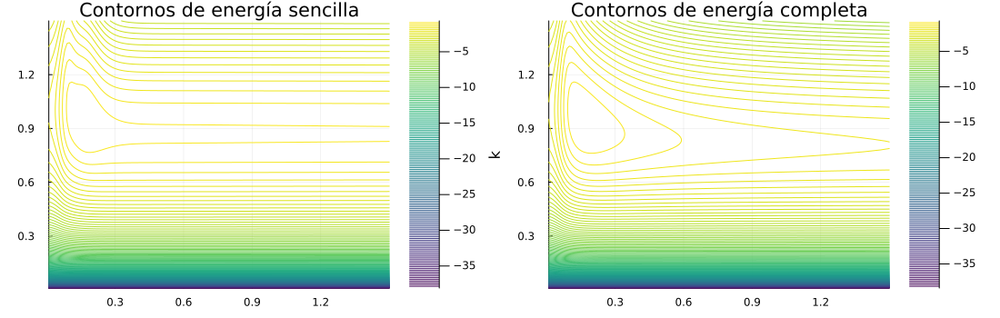

In [25]:
f(x, y) = energypre((x,y))
g(x, y) = energycomplete((x,y))

x_range = 0.01:0.01:1.5
y_range = 0.01:0.01:1.5
mesh_x = zeros(length(x_range), length(y_range))
mesh_y = zeros(length(x_range), length(y_range))
for i in 1:length(x_range)
    for j in 1:length(y_range)
        mesh_x[i, j] = x_range[i]
        mesh_y[i, j] = y_range[j]
    end
end


pre_values = f.(mesh_y, mesh_x)
com_values = g.(mesh_y, mesh_x)

pre_gr = contour(x_range, y_range, pre_values, levels=150, color=:viridis, xlabel="r", ylabel="k", title="Contornos de energía sencilla")
com_gr = contour(x_range, y_range, com_values, levels=150, color=:viridis, xlabel="r", ylabel="k", title="Contornos de energía completa")

plot(pre_gr,com_gr,layout=(1,2),size=(1100,350))

En el siguiente fragmento de código se ejecuta el algoritmo MHRW precondicionado. Se realiza la modificación de aceptar o rechazar una muestra en primer lugar con la energía "sencilla" y luego, de ser aceptada, sí se evalúa la muestra con la energía completa. Debe tenerse en cuenta que la probabilidad de aceptación y rechazo cambia dependiendo con qué energía se testee.

In [26]:
# Número de iteraciones
iterations = 10000
# Punto inicial donde r y K seleccionados de manera aleatoria en (0,1)
samples = rand(2) 

probabilitiespre = [exp(energypre(samples[:,end]))] # energía precondicionada
probabilitiescom = [exp(energycomplete(samples[:,end]))] # energía precondicionada

Alphapre = [0] # tasa de aceptación
Alphacomplete = [0]
sd = 0.05 # desviación estándar del camino aleatorio

# MHRW
for i in 1:iterations
    # Construcción de nuevas muestras con un camino aleatorio normal
    theta = samples[:,end]+ sd*randn(2)

    # Condición del soporte: Evaluación precondicionada
    if support(theta) == false
        alphapre = 0
        p2 = exp(energypre(samples[:,end]))
    else
        p1 = exp(energypre(theta))
        p2 = exp(energypre(samples[:,end]))
        alphapre = min(1, p1/p2)
    end 
    
    Alphapre = hcat(Alphapre,alphapre)
    u = rand()

    #Selección de muestras
    if u < alphapre
        #Aceptación
        probabilitiespre = hcat(probabilitiespre,p1)
         #Test con la energía completa
        p3 = exp(energycomplete(theta))
        p4 = exp(energycomplete(samples[:,end]))
         #Tasa de aceptación con la energía completa
        alphacomplete = min(1, (p1/p2)*(p4/p3))

        Alphacomplete = hcat(Alphacomplete,alphacomplete)
        v = rand()
        if v < alphacomplete
            #Aceptación
            samples = hcat(samples, theta)
            probabilitiescom = hcat(probabilitiescom,p3)
        else 
            #Rechazo
            samples = hcat(samples, samples[:,end])
        end
    else
        #Rechazo
        samples = hcat(samples, samples[:,end])
        probabilities = hcat(probabilitiespre,p2)
    end
end


# Muestreo sistemático
initial_position = floor(100*rand())
leap = 20
samples_ss = samplesED[:, Int(initial_position):leap:end]
probabilities_ss = probabilitiespre[Int(initial_position):leap:end];

#Estadísticas de interés
max_prob, position_ss = findmax(probabilities_ss)
Max_likelihood = samples_ss[:, position_ss]
Mean = mean(samples_ss, dims=2)

@show (r0,K0)
@show Max_likelihood
@show Mean;

(r0, K0) = (0.2, 750)
Max_likelihood = [0.20437101987951536, 0.7106156955026843]
Mean = [0.2014756279299458; 0.7495946745824581;;]


Con este algoritmo se obtienen resultados favorables en relación con la calidad de aproximación a los parámetros con los que se generaron los datos.

Por otra parte, la tasa de aceptación en la energía para el precondicionamiento posee un comportamiento más distribuido en el intervalo $[0,1]$ con tendencia a generar valores cercanos a $1$, evidenciando la pérdida de rigurosidad al rechazar muestras, y luego, la aceptación casi segura de todas las muestras que pase por la energía completa.

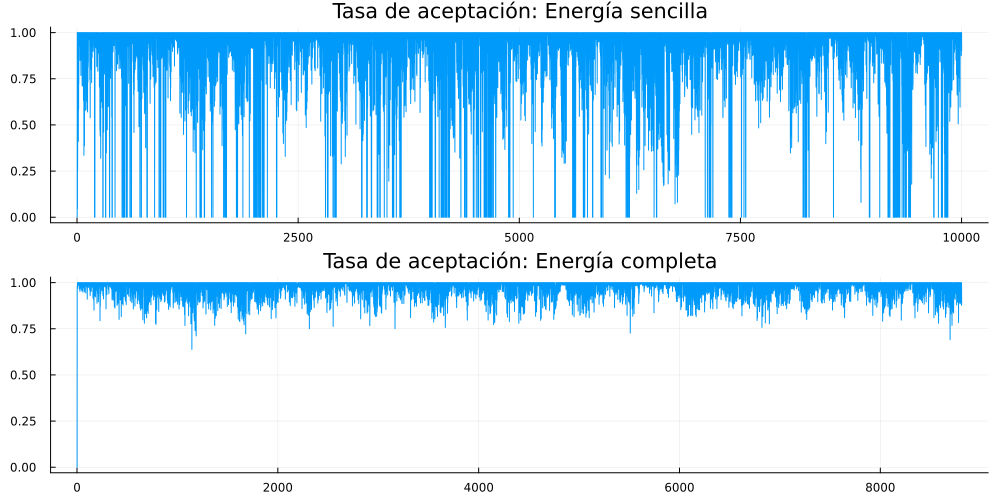

In [32]:
pα1 = plot(Alphapre[1,:],label="",title="Tasa de aceptación: Energía sencilla")
pα2 = plot(Alphacomplete[1,:],label="",title="Tasa de aceptación: Energía completa")
plot(pα1,pα2, layout=(2,1), size=(1000,500))